**TASK 3 File**

In [6]:
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import tensorflow as tf  
import pandas as pd
import os
import cv2
import random
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
from PIL import Image

In [3]:
#Changing the numbering of the files to start with 0.

# Define the source and destination directory
src_dir = 'D:/FAST_NUCES/7thSemester/DLP/Assignment/Assignment1/Dataset/yale_copy'
dst_dir = 'D:/FAST_NUCES/7thSemester/DLP/Assignment/Assignment1/Dataset/task3_yale'

# Loop through all files in the source directory
for filename in os.listdir(src_dir):
    # Check if the file is an image
    if filename.endswith('.centerlight') or filename.endswith('.glasses') or filename.endswith('.happy') or filename.endswith('.leftlight') or filename.endswith('.noglasses') or filename.endswith('.normal') or filename.endswith('.rightlight') or filename.endswith('.sad') or filename.endswith('.sleepy') or filename.endswith('.surprised') or filename.endswith('.wink'):
        # Extract the subject number from the file name
        subject_num = int(filename.split('.')[0].replace('subject', ''))

        # Subtract 1 from the subject number
        new_subject_num = subject_num - 1

        # Construct the new file name
        new_filename = f'subject{new_subject_num:02d}.{filename.split(".")[1]}'

        # Rename the file and move it to the destination directory
        os.rename(os.path.join(src_dir, filename), os.path.join(dst_dir, new_filename))

#as a consequence of this code the yale_copy folder is empty now
#and all the files are in the task3_yale folder with the numbering starting from zero.

In [4]:
#Converting all the gif files of different emotion extensions to jpg to make 
#using the haar cascade code easier
#saving them to a separate output folder.


# Define the directory containing the images
dir_path = 'D:/FAST_NUCES/7thSemester/DLP/Assignment/Assignment1/Dataset/task3_yale'
out_path= 'D:/FAST_NUCES/7thSemester/DLP/Assignment/Assignment1/Dataset/jpegversions'
# Loop through all files in the directory
for filename in os.listdir(dir_path):
    # Check if the file is an image
    if filename.endswith('.centerlight') or filename.endswith('.glasses') or filename.endswith('.happy') or filename.endswith('.leftlight') or filename.endswith('.noglasses') or filename.endswith('.normal') or filename.endswith('.rightlight') or filename.endswith('.sad') or filename.endswith('.sleepy') or filename.endswith('.surprised') or filename.endswith('.wink'):
        # Open the image
        img = Image.open(os.path.join(dir_path, filename))

        # Convert to JPEG and save
        output_path = os.path.join(out_path, f'{os.path.splitext(filename)[0]}_{os.path.splitext(filename)[1][1:]}.jpg')
        img.save(output_path, 'JPEG')


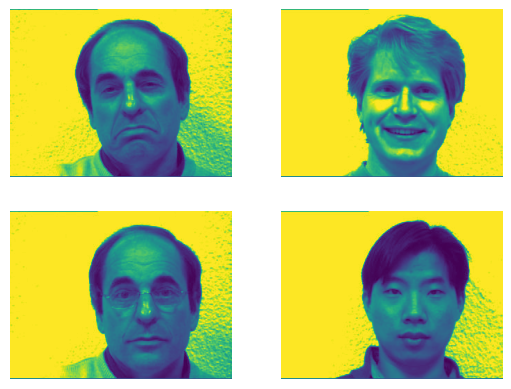

In [12]:
#Display some of the images at random from the folder
#To show they've successfully been captured in image form!

# Define the directory containing the images
dir_path = 'D:/FAST_NUCES/7thSemester/DLP/Assignment/Assignment1/Dataset/jpegversions'

# Get a list of all image files in the directory
image_files = [f for f in os.listdir(dir_path) if f.endswith('.jpg') or f.endswith('.png')]

# Choose 4 random images from the list
random_images = random.sample(image_files, 4)

# Display the random images
fig, axs = plt.subplots(2, 2)
for i, image_file in enumerate(random_images):
    image_path = os.path.join(dir_path, image_file)
    image = Image.open(image_path)
    row = i // 2
    col = i % 2
    axs[row, col].imshow(image)
    axs[row, col].axis('off')
plt.show()

#They're actually grey scale but are showing in this colour here!



C:\Users\rahei\AppData\Local\Temp\ipykernel_6328\1632051122.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1,1)


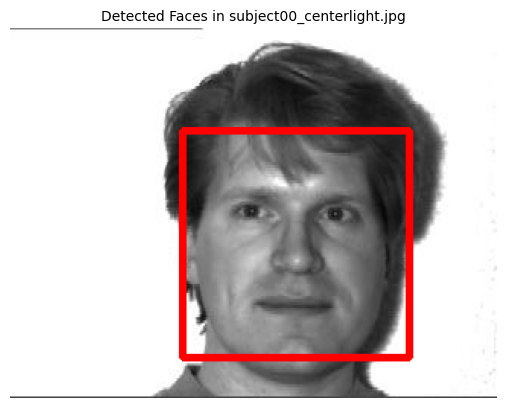

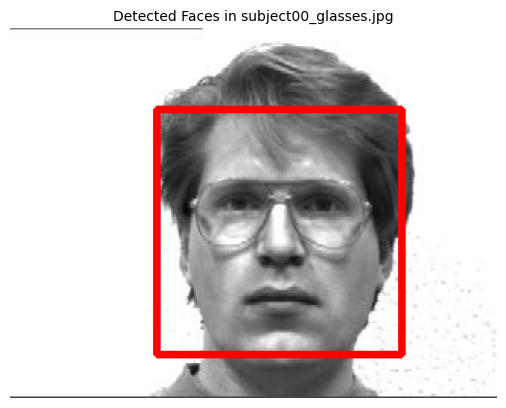

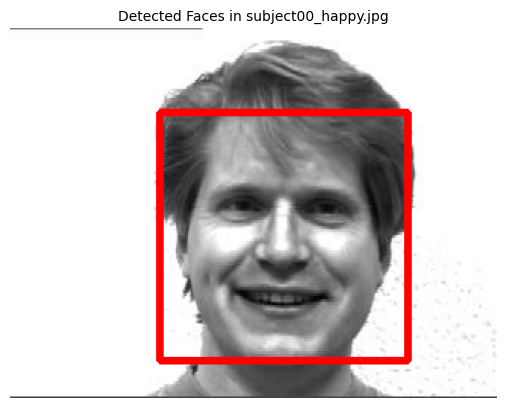

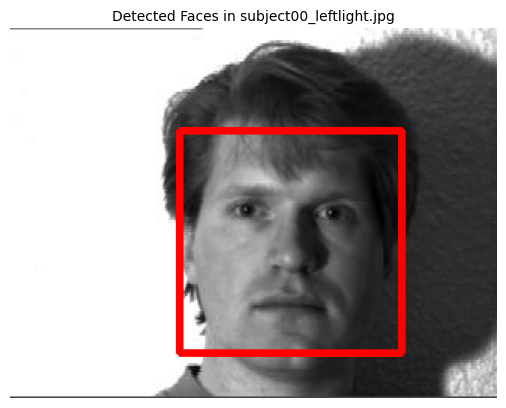

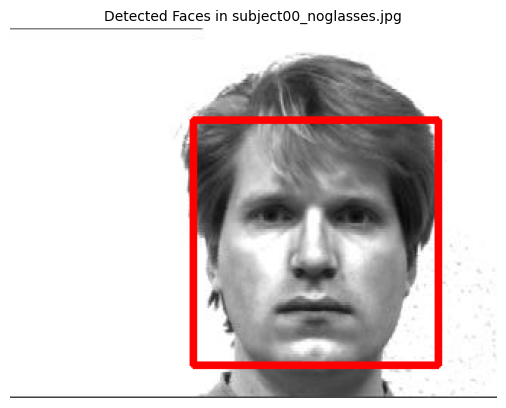

...

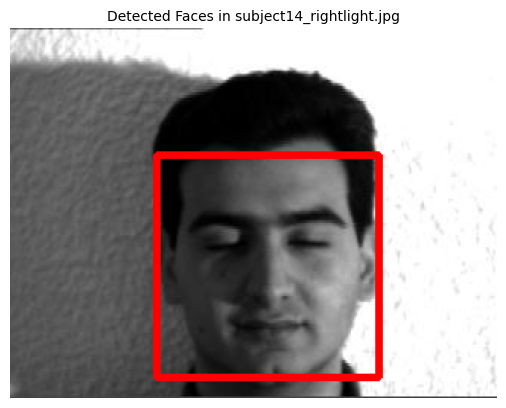

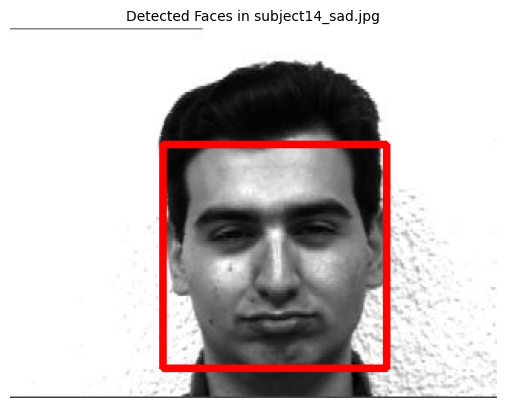

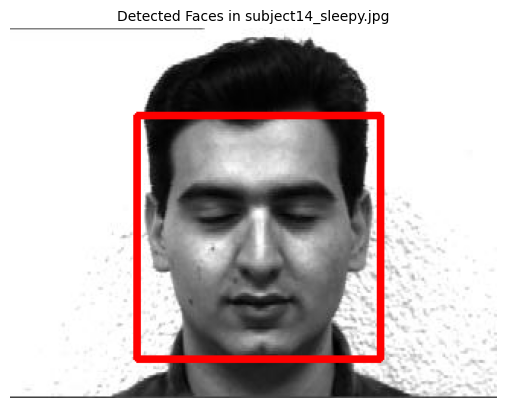

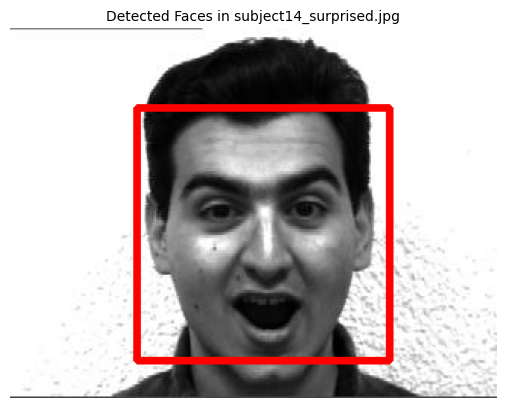

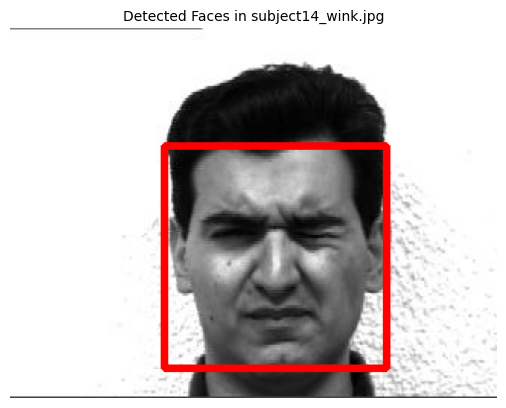

In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Load the cascade
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')

# Define the directory containing the images
dir_path = 'D:/FAST_NUCES/7thSemester/DLP/Assignment/Assignment1/Dataset/jpegversions'

# Loop through all files in the directory
for filename in os.listdir(dir_path):
    # Check if the file is an image
    if filename.endswith('.jpg') or filename.endswith('.png'):
        # Load the image
        img_path = os.path.join(dir_path, filename)
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Detect faces
        faces = face_cascade.detectMultiScale(gray, 1.1, 4)

        # Draw rectangle around the faces
        for (x, y, w, h) in faces:
            cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 255), 3)

        fig, axs = plt.subplots(1,1)
        rgb = cv2.cvtColor(img,cv2.COLOR_BGR2RGB)
        axs.imshow(rgb)
        axs.axis('off')
        axs.set_title(f'Detected Faces in {filename}',fontsize='medium')


C:\Users\rahei\AppData\Local\Temp\ipykernel_6328\2718401426.py:42: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, axs = plt.subplots(1, 1)


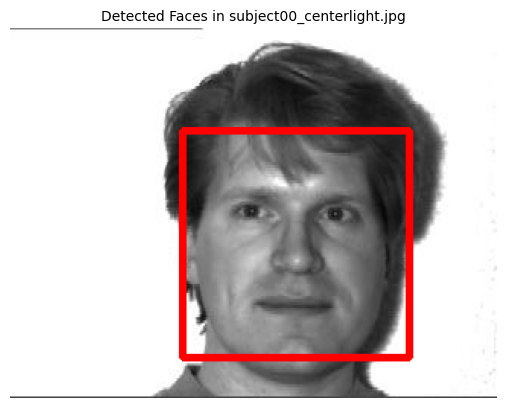

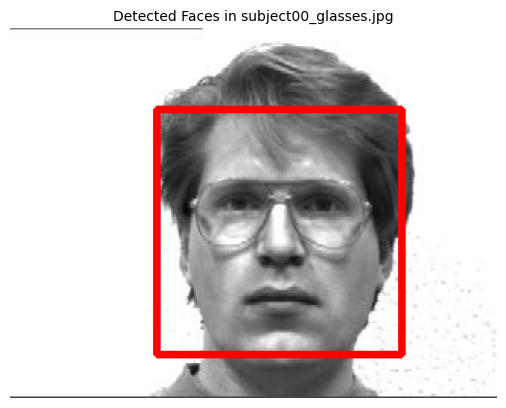

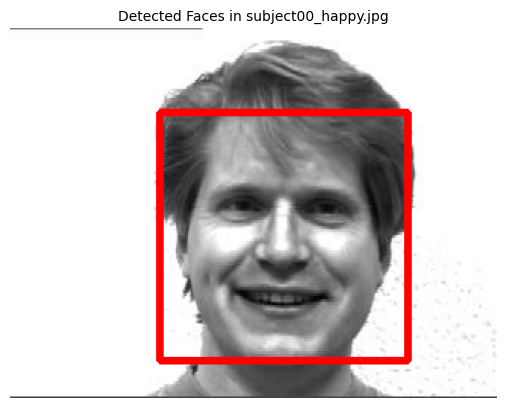

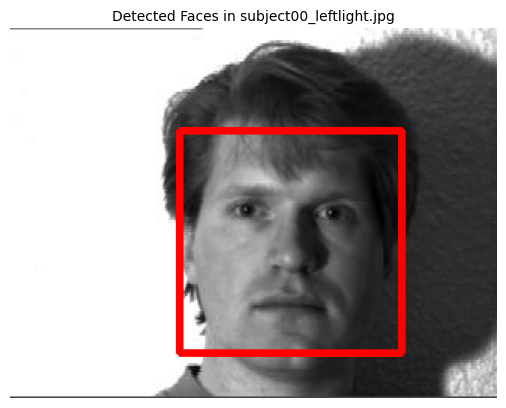

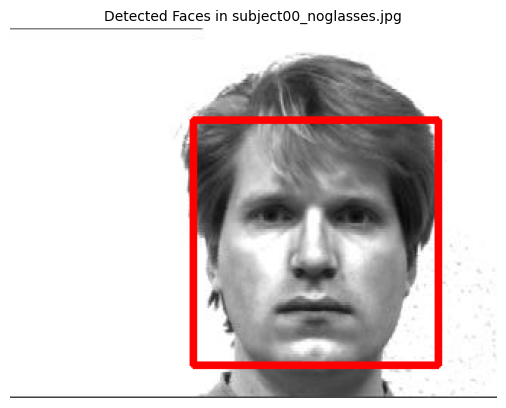

...

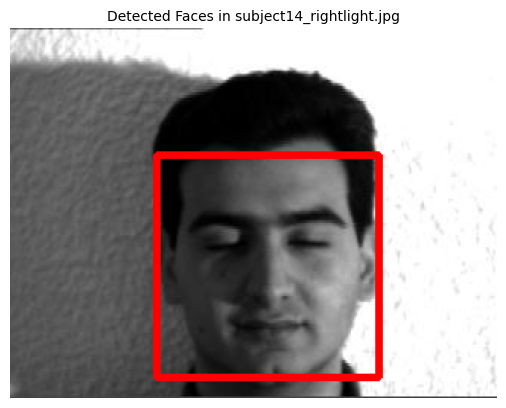

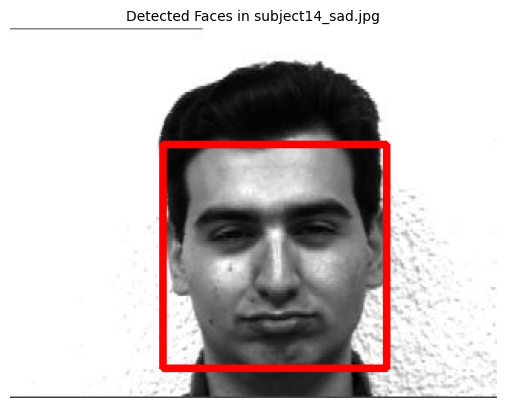

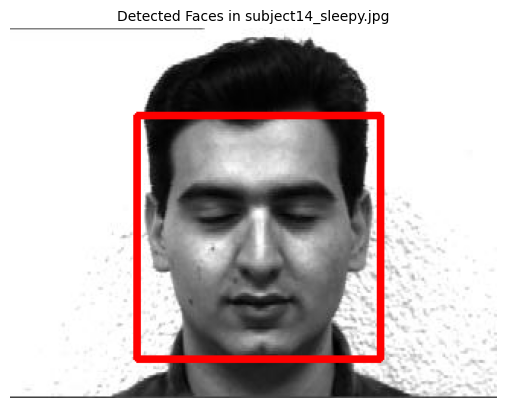

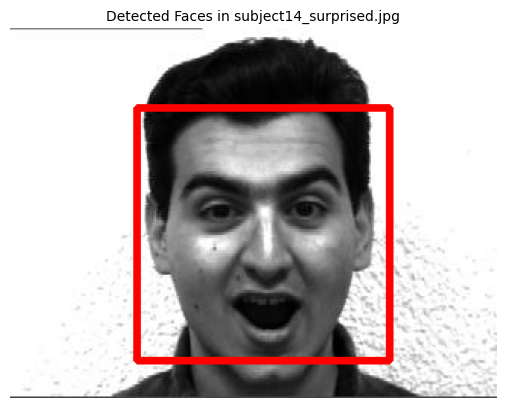

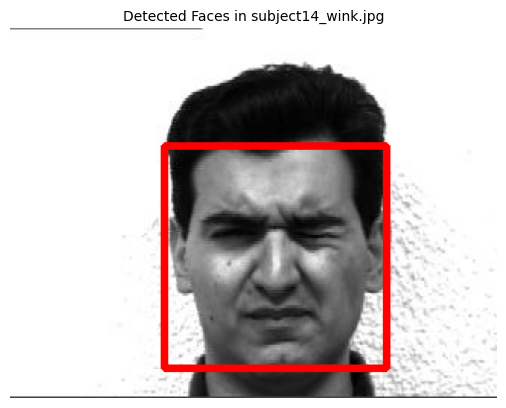

In [18]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import os

# Load the cascade
face_cascade = cv2.CascadeClassifier('haarcascade_frontalface_default.xml')

# Define the directory containing the images
dir_path = 'D:/FAST_NUCES/7thSemester/DLP/Assignment/Assignment1/Dataset/jpegversions'

# Create a directory to store cropped face images
output_dir = 'D:/FAST_NUCES/7thSemester/DLP/Assignment/Assignment1/Dataset/faceonly'

# Loop through all files in the directory
for filename in os.listdir(dir_path):
    # Check if the file is an image
    if filename.endswith('.jpg') or filename.endswith('.png'):
        # Load the image
        img_path = os.path.join(dir_path, filename)
        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

        # Detect faces
        faces = face_cascade.detectMultiScale(gray, 1.1, 4)

        # Process each detected face
        for i, (x, y, w, h) in enumerate(faces):
            # Crop the detected face region
            face_roi = img[y:y+h, x:x+w]
            
            # Define the output file path for the cropped face
            output_path = os.path.join(output_dir, filename.split('.')[0] + '.jpg')

            # Save the cropped face as an image
            cv2.imwrite(output_path, face_roi)

            # Draw rectangle around the detected face (optional)
            cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 255), 3)

        # Display the image with detected faces (optional)
        fig, axs = plt.subplots(1, 1)
        rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        axs.imshow(rgb)
        axs.axis('off')
        axs.set_title(f'Detected Faces in {filename}', fontsize='medium')

# Display plots (optional)
plt.show()


In [ ]:
# Load and preprocess the data
data = []  # List to store image data
labels = []  # List to store labels

# Load the cascade
face_cascade = cv2.CascadeClassifier('models/haarcascade_frontalface_default.xml')

# Define a function to extract the person label from the file name
def extract_person_label(file_name):
    return int(file_name.split('.')[0].replace('subject', '')) - 1  # Subtract 1 to make labels start from 0

# Load data and labels
# Assuming the dataset files are in the 'dataset' directory
dataset_dir = 'D:/FAST_NUCES/7thSemester/DLP/Assignment/Assignment1/Dataset/yale'

for file_name in os.listdir(dataset_dir):
    img = plt.imread(os.path.join(dataset_dir, file_name))
    img = cv2.imread(path, cv2.IMREAD_COLOR)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    data.append(img.flatten())  # Flatten image into a 1D array
    labels.append(extract_person_label(file_name))

data = np.array(data)
labels = np.array(labels)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=42)
